In [2]:
#import spikeinterface modules
import spikeinterface as si
import spikeinterface.extractors as se
import spikeinterface.toolkit as st
import spikeinterface.sorters as ss
import spikeinterface.comparison as sc
import spikeinterface.widgets as sw
import numpy as np
import glob

#import everything else
import os
import sys
import numpy as np
import neo
import pandas as pd
import h5py
import McsPy
import sys, importlib, os
import McsPy.McsData
import McsPy.McsCMOS
from McsPy import ureg, Q_
import matplotlib.pyplot as plt
from matplotlib.pyplot import cm
import seaborn as sns
import itertools

from time import strftime
%matplotlib inline

In [322]:
# helper line -> get different outpaths for sorted datasets; uncheck the date

#191021
#mainpath = 'D:\Files_Reutlingen_Jenny\main_191021'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191021\_output_Spikesorting_30042021_hCSF_adult_20min_spont_spikesorting'
# outpath = 'D:\Files_Reutlingen_Jenny\main_191021\_output_Spikesorting_30042021_hCSF_adult_20min_spont0001_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191021\_output_Spikesorting_30042021_hCSF_child_20min_spont0001_spikesorting'



#191021extra
mainpath = 'D:\Files_Reutlingen_Jenny\main_191021extra'
outpath = 'D:\Files_Reutlingen_Jenny\main_191021extra\_output_Spikesorting_19042021_aCSF_adult_15min_spont_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191021extra\_output_Spikesorting_23042021_hCSF_adult_20min_spont0002_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191021extra\_output_Spikesorting_29042021_hCSF_child_20min_spont_spikesorting'


#191017
#mainpath = 'D:\Files_Reutlingen_Jenny\main_191017'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191017\_output_Spikesorting_30042021_spontaneous_spikesorting'



#191023
#mainpath = 'D:\Files_Reutlingen_Jenny\main_191023'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_DNQX_AP5_washin_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_DNQX_AP5_washin0001_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_hCSF_afterDNQX_AP5_washin_spikesorting'
#outpath = 'D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting'


labeldic =  np.load(
    'D:\Files_Reutlingen_Jenny\_layerdictionaries\labeldictionary_MCS_256MEA.npy', 
    allow_pickle='TRUE').item() 


filedirec = mainpath
inputdirectory = r"D:\Files_Reutlingen_Jenny\main_191021extra\191021_extra"
plotdirectory = r"D:\Files_Reutlingen_Jenny\Plots"
os.chdir(inputdirectory)

In [323]:
filelist = glob.glob('*spont*.h5')
filelist

['aCSF_adult_15min_spont.h5',
 'hCSF_adult_20min_spont0002.h5',
 'hCSF_child_20min_spont.h5']

In [324]:
labeldic =  np.load(
    'D:\Files_Reutlingen_Jenny\_layerdictionaries\labeldictionary_MCS_256MEA.npy', 
    allow_pickle='TRUE').item() 

labeldic_invert = {}

for key in labeldic:
    keystring = str(labeldic[key])
    labeldic_invert[keystring] = key

In [329]:
filename=filelist[0]
filebase = filename.split('.')[0]
filebase

mainbase = mainpath.split("main_")[-1]

In [330]:
filebase

'aCSF_adult_15min_spont'

In [331]:


subplotpath = os.path.join(plotdirectory, mainbase, filebase)


In [332]:
subplotpath

'D:\\Files_Reutlingen_Jenny\\Plots\\191021extra\\aCSF_adult_15min_spont'

In [333]:

def load_dumped_subrecordings(directory, filebase):

    subrecording_dic = {}
    filelist = glob.glob('*recording.pkl')
    for file in filelist:
        key = file.split(filebase)[1].split('.')[0].split('_recording')[0]
        subrecording_dic[key]=se.load_extractor_from_pickle(file)
        
    return subrecording_dic
        
    
def load_dumped_sorted_dic(outpath):

    sorted_dic = {}
    filelist = glob.glob('*sorted*')
    for file in filelist:
        key = file.split('sorted_')[1]
        sorted_dic[key]=se.SpykingCircusSortingExtractor(file)
        
    return sorted_dic


# function to get the filebase from folder
def get_filebase_from_foldername(mainpath_folder):
    
    separator = '_'
    filebase = separator.join(mainpath_folder.split('\\')[-1].split('_')[4:-1])
    
    return filebase



In [334]:
os.chdir(outpath)

In [335]:
loaded = load_dumped_subrecordings(outpath, filebase)
sorted_dic = load_dumped_sorted_dic(outpath)

In [336]:
loaded


{'sec_0-300': <spikeextractors.extractors.bindatrecordingextractor.bindatrecordingextractor.BinDatRecordingExtractor at 0x28880da6550>,
 'sec_300-600': <spikeextractors.extractors.bindatrecordingextractor.bindatrecordingextractor.BinDatRecordingExtractor at 0x2493e93e1f0>,
 'sec_600-900': <spikeextractors.extractors.bindatrecordingextractor.bindatrecordingextractor.BinDatRecordingExtractor at 0x26ab6dee0d0>}

In [337]:
sorted_dic

{'sec_0-300': <spikeextractors.extractors.spykingcircusextractors.spykingcircusextractors.SpykingCircusSortingExtractor at 0x28884bba340>,
 'sec_300-600': <spikeextractors.extractors.spykingcircusextractors.spykingcircusextractors.SpykingCircusSortingExtractor at 0x28884bba730>,
 'sec_600-900': <spikeextractors.extractors.spykingcircusextractors.spykingcircusextractors.SpykingCircusSortingExtractor at 0x288815f40d0>}

Plot activity map

In [300]:
# fig, ax = plt.subplots(1,1, figsize=(8, 8))

# sw.plot_activity_map(loaded['sec_0-120'], cmap='viridis', colorbar = True, log= False, ax=ax, figure=fig)
# ax.set_title('Activity Map 191017 %s' %filebase)

# fig.savefig(os.path.join(subplotpath, 'Activity_Map_191017_%s ' %filebase),  dpi=300) 

# machen keine sinnvolle activity, ursache hierfür a.e. die chaotische Repräsentation der Daten innerhalb der Recordings 

Load in the DataFrame

In [338]:
os.chdir(outpath)

In [339]:
completeframe = pd.read_pickle(str('DF_' + filebase + '_' + 'complete') + '_df.pkl')

In [120]:
completeframe.groupby(['channellabel']).describe()['firing_rate']

,count,mean,std,min,25%,50%,75%,max
channellabel,,,,,,,,
A11,1.0,2.933334,NaN,2.933334,2.933334,2.933334,2.933334,2.933334
A5,1.0,2.100001,NaN,2.100001,2.100001,2.100001,2.100001,2.100001
A6,1.0,4.008335,NaN,4.008335,4.008335,4.008335,4.008335,4.008335
A7,1.0,1.183334,NaN,1.183334,1.183334,1.183334,1.183334,1.183334
A9,1.0,0.775000,NaN,0.775000,0.775000,0.775000,0.775000,0.775000
...,...,...,...,...,...,...,...,...
R2,1.0,2.208334,NaN,2.208334,2.208334,2.208334,2.208334,2.208334
R4,3.0,0.838889,0.863711,0.216667,0.345833,0.475000,1.150000,1.825001
R5,1.0,6.141669,NaN,6.141669,6.141669,6.141669,6.141669,6.141669


In [340]:
completeframe

,unit_ids,max_channel,unit_index,channellabel,n_spikes,firing_rate,layer,file,subrecording,recordingdate
0,0,0.0,0.0,R12,52.0,0.173333,layer2-3,aCSF_adult_15min_spont,sec_0-300,21.10.2019
1,1,10.0,1.0,R4,377.0,1.256667,layer2-3,aCSF_adult_15min_spont,sec_0-300,21.10.2019
2,10,30.0,2.0,O11,281.0,0.936667,layer2-3,aCSF_adult_15min_spont,sec_0-300,21.10.2019
3,100,61.0,3.0,I14,207.0,0.690000,layer5-6,aCSF_adult_15min_spont,sec_0-300,21.10.2019
4,101,61.0,4.0,I14,677.0,2.256667,layer5-6,aCSF_adult_15min_spont,sec_0-300,21.10.2019
...,...,...,...,...,...,...,...,...,...,...
743,95,41.0,743.0,L7,904.0,3.013333,layer4,aCSF_adult_15min_spont,sec_600-900,21.10.2019
744,96,41.0,744.0,L7,725.0,2.416667,layer4,aCSF_adult_15min_spont,sec_600-900,21.10.2019
745,97,41.0,745.0,L7,394.0,1.313333,layer4,aCSF_adult_15min_spont,sec_600-900,21.10.2019
746,98,73.0,746.0,K8,6.0,0.020000,layer5-6,aCSF_adult_15min_spont,sec_600-900,21.10.2019


1. Get the n-channels with highest firing rate

In [341]:
#filteredframe = completeframe.loc[(completeframe['qm_isi_violation']<0.5) & (completeframe['qm_amplitude_cutoff'] < 0.1) & (completeframe['qm_presence_ratio'] > 0.9)]

In [342]:
filtered_units = completeframe['max_channel'].unique()

In [343]:
len(filtered_units)

251

In [344]:
u = 'sec_0-300'

In [345]:
os.getcwd()

'D:\\Files_Reutlingen_Jenny\\main_191021extra\\_output_Spikesorting_19042021_aCSF_adult_15min_spont_spikesorting'

In [346]:
sorted_dic[u]

Get the unitwaveforms

In [347]:

wf = st.postprocessing.get_unit_waveforms(loaded[u], sorted_dic[u], ms_before=1, ms_after=2,
                                          save_as_features=True, verbose=True)

Number of chunks: 31 - Number of jobs: 1


Extracting waveforms in chunks: 100%|##################################################| 31/31 [07:19<00:00, 14.17s/it]


In [348]:
templates = st.postprocessing.get_unit_templates(loaded[u], sorted_dic[u], max_spikes_per_unit=1, 
                                                 save_as_property=True, verbose=True)

In [349]:
subplotpath

'D:\\Files_Reutlingen_Jenny\\Plots\\191021extra\\aCSF_adult_15min_spont'

In [190]:
# Function works for simple unit_ids

def plot_template_plot(unit_ids, dataframe):
    
    
    for unit in unit_ids:
        
        
        i = int(dataframe.loc[(dataframe['unit_ids']==unit)]['unit_index'])
        n = len(unit_ids)
        colors = iter(cm.jet(np.linspace(0, 1, len(unit_ids))))

        plt.style.use("seaborn-white")

        # get max chanel:
        j = int(dataframe[(dataframe['unit_ids']==unit)]['max_channel'])
        # acount for MCS counting system
        if j > 125:
            j = j-2

        fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))

        sw.plot_unit_template_maps(loaded[u],  sorted_dic[u], max_spikes_per_unit=100, unit_ids=[unit], ax=ax2)


        colourcode = color=next(colors)
        ax1.plot(templates[i][j].T, color=colourcode)
        ax1.set_title(str(dataframe.loc[i]['channellabel']) + ' Unit Templates')

        ax3.plot(wf[i][:, j, :].T, color=colourcode, lw=0.05)
        ax3.set_title(str(dataframe.loc[i]['channellabel']) + ' Waveforms')

        #sw.plot_crosscorrelograms(sorted_dic[u], unit_ids=unitlist_by_index, ax=ax4, bin_size=1, window=10)


        sw.plot_rasters(sorted_dic[u], color='k', unit_ids=[unit], ax = ax4)
        
        try:
            os.mkdir(subplotpath)
        except OSError:
            print ("Creation of the directory %s failed" % outpath)
        else:
            print ("Successfully created the directory %s " % outpath)
        os.chdir(subplotpath)

        fig.savefig('unitplot_%s.png' %unit, dpi=300)

In [350]:
unit_ids = completeframe.loc[(completeframe['subrecording']==u)]['unit_ids']

Successfully created the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting 
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed
Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesort

<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


Creation of the directory D:\Files_Reutlingen_Jenny\main_191023\_output_Spikesorting_29042021_spontaneous_spikesorting failed


<ipython-input-190-4c0a2a2fb1c1>:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 20))


KeyboardInterrupt: 

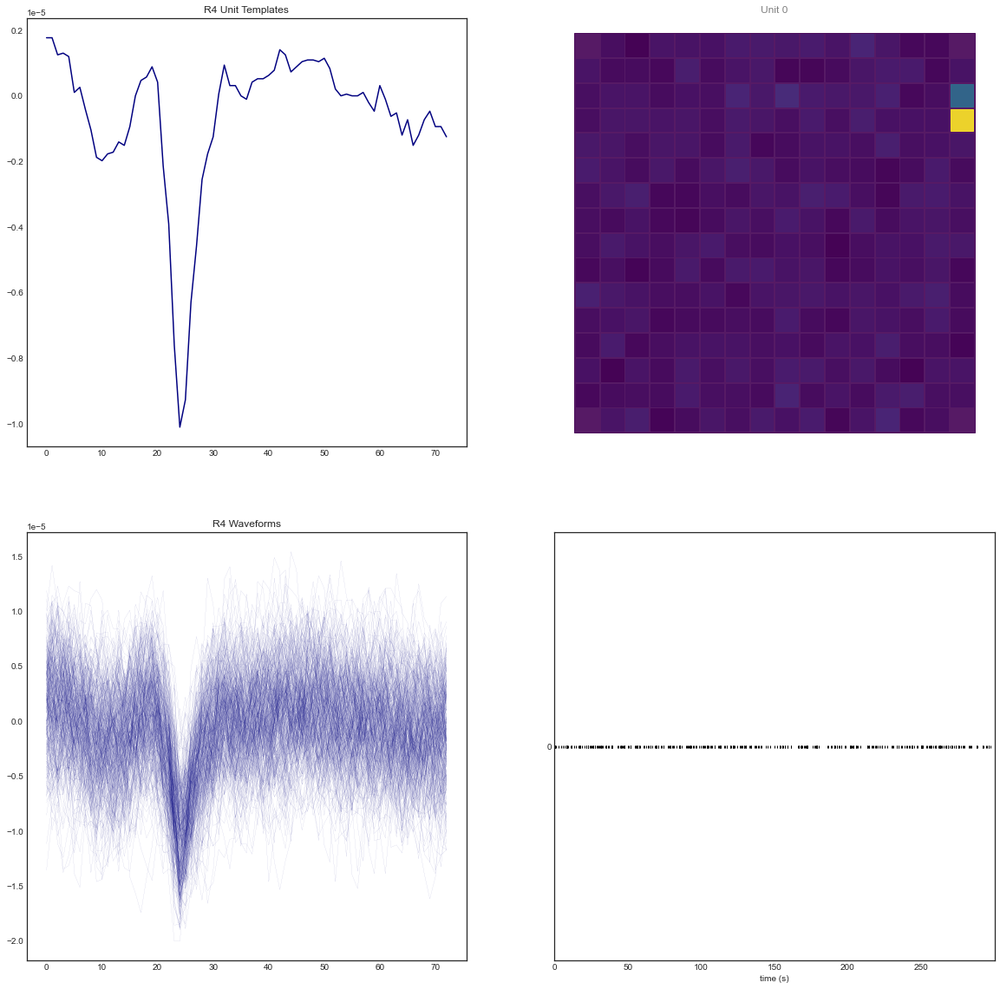

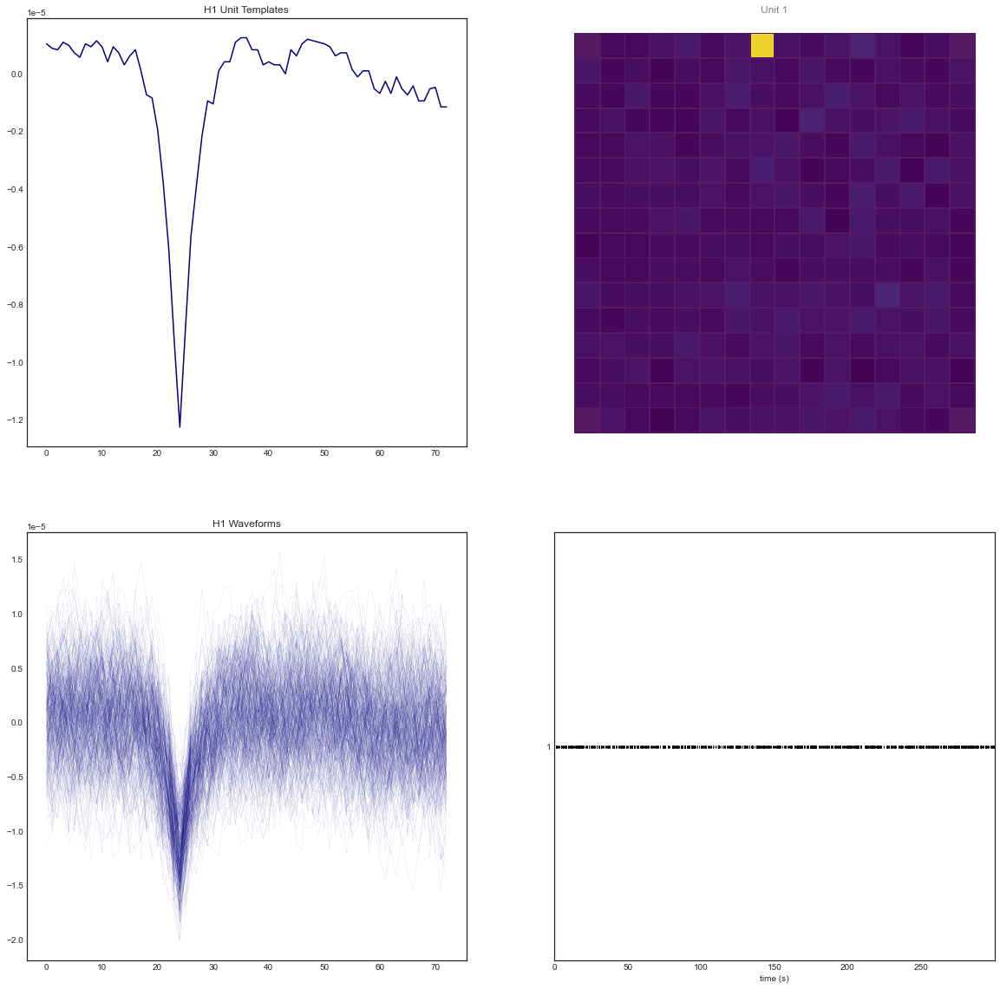

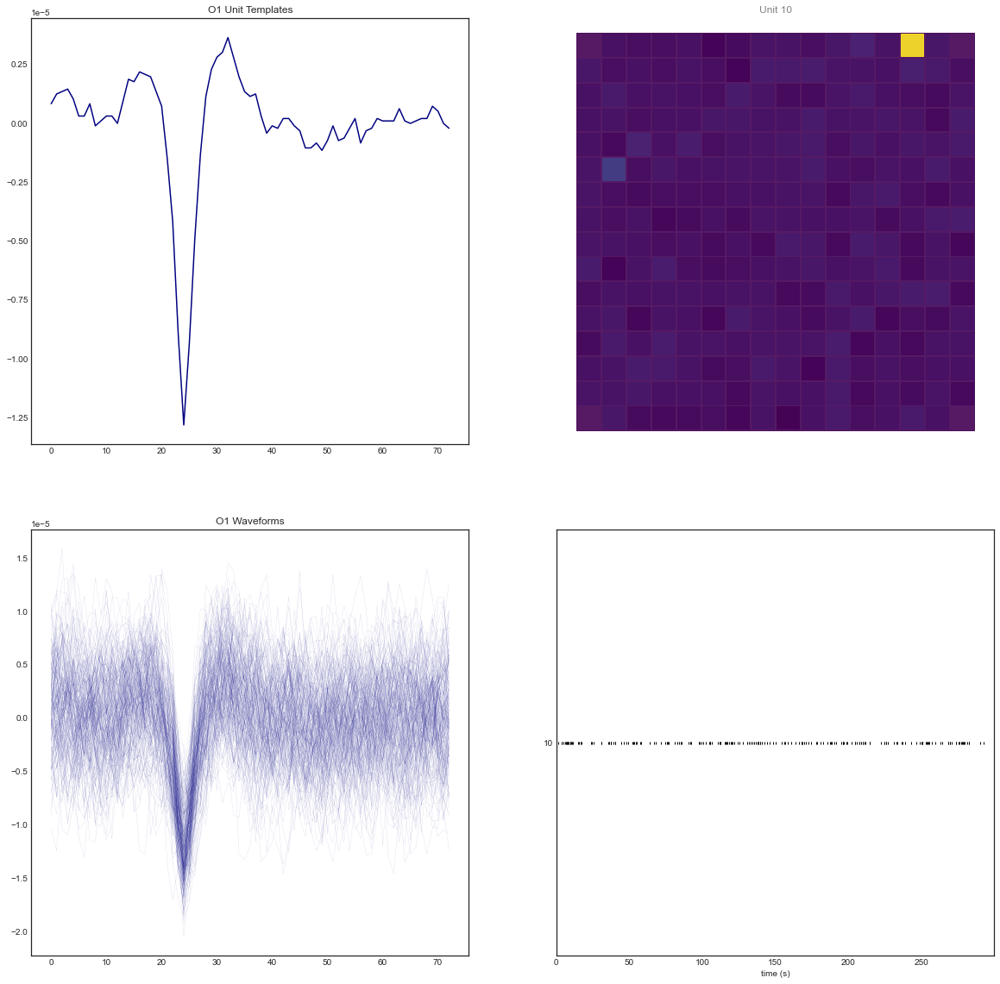

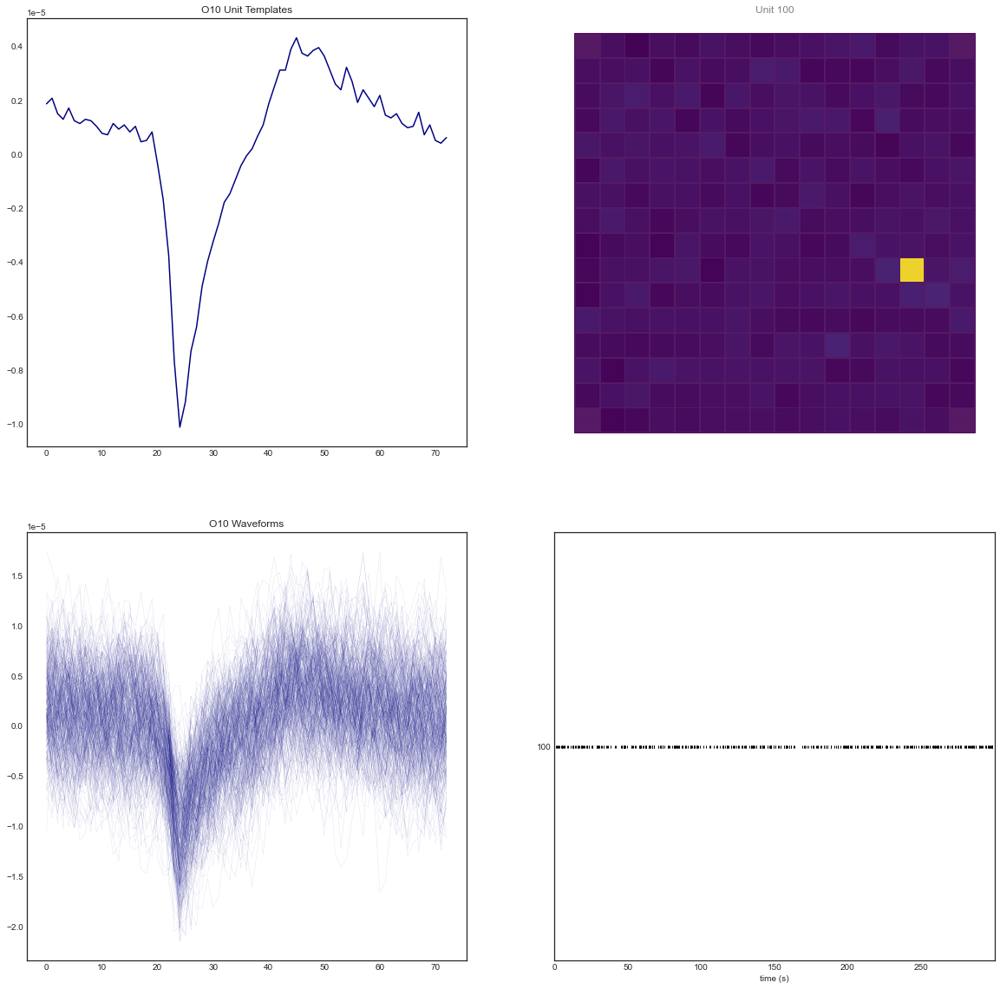

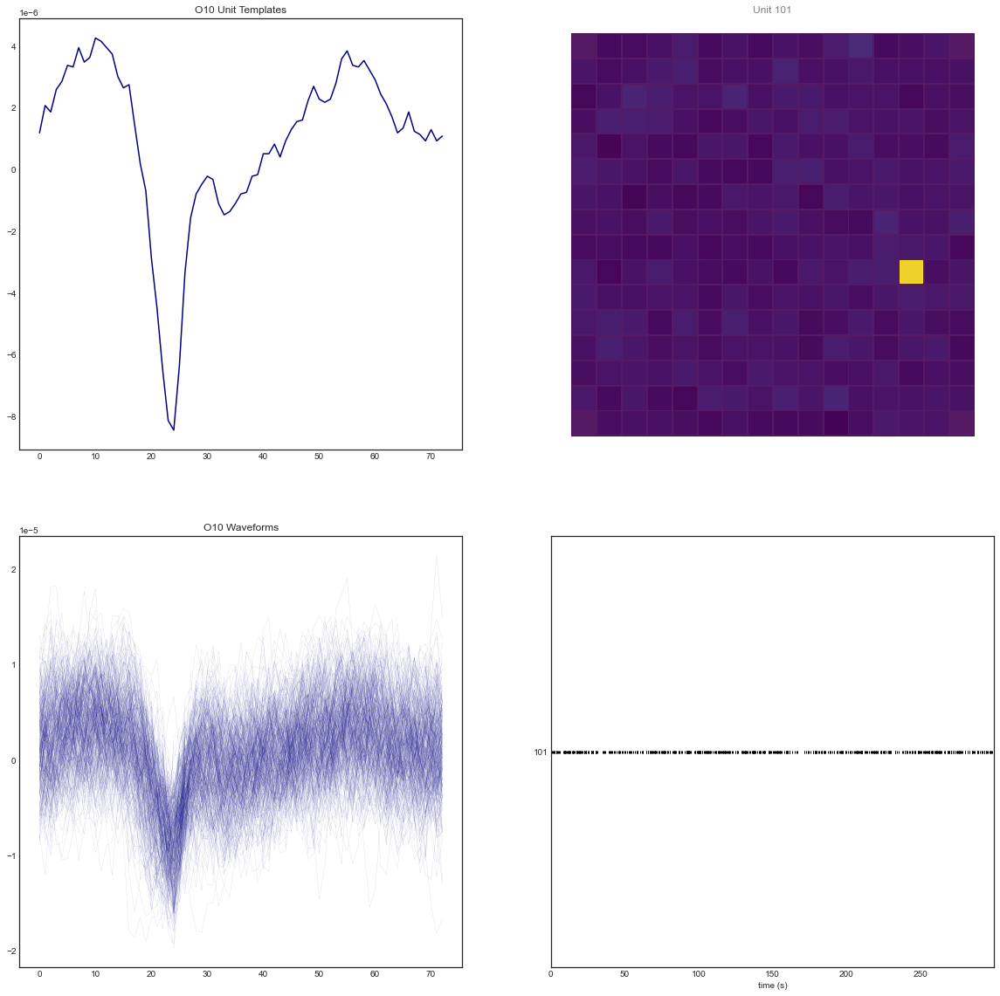

...

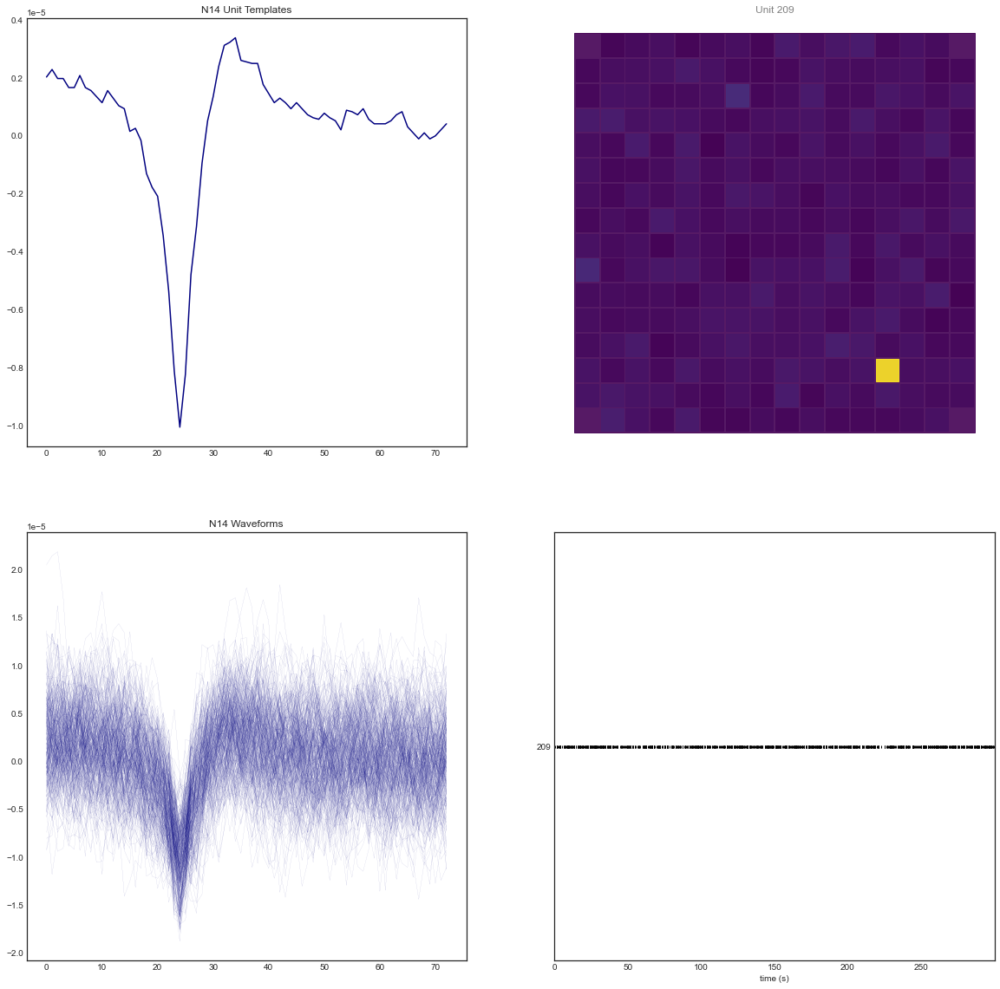

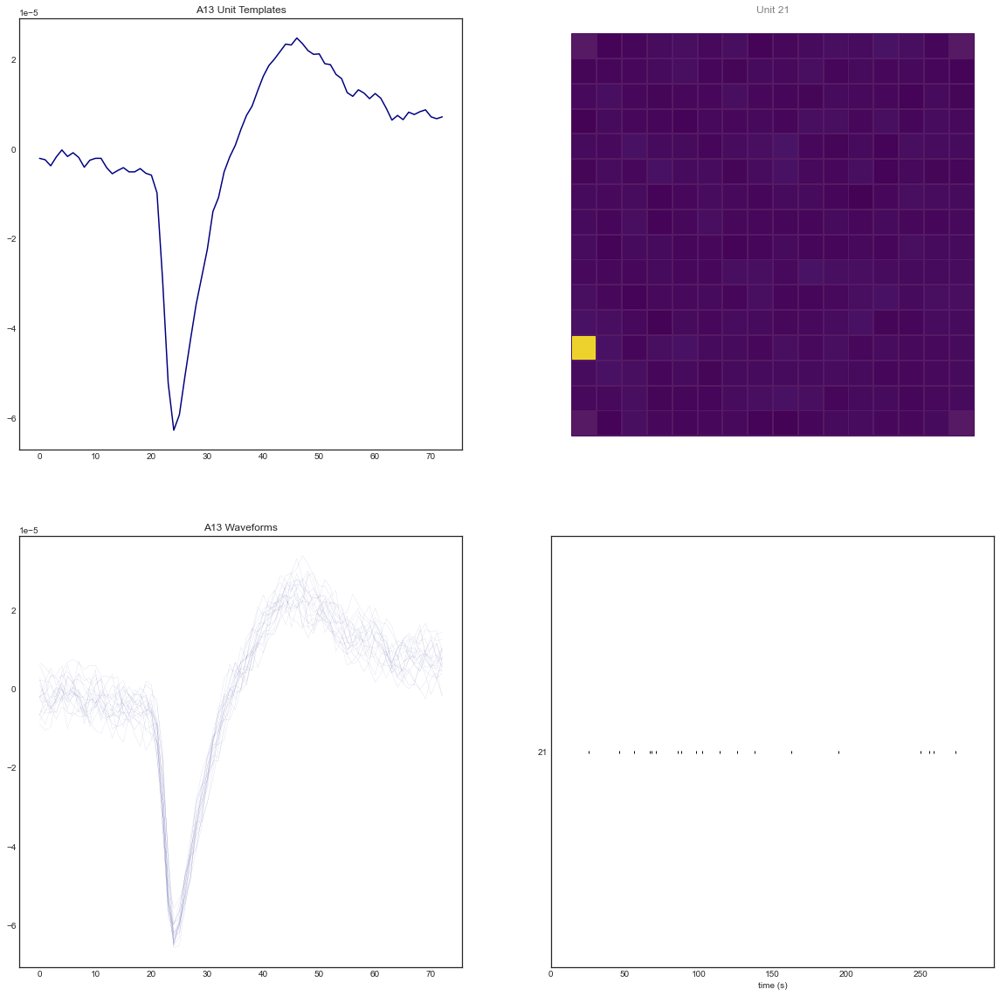

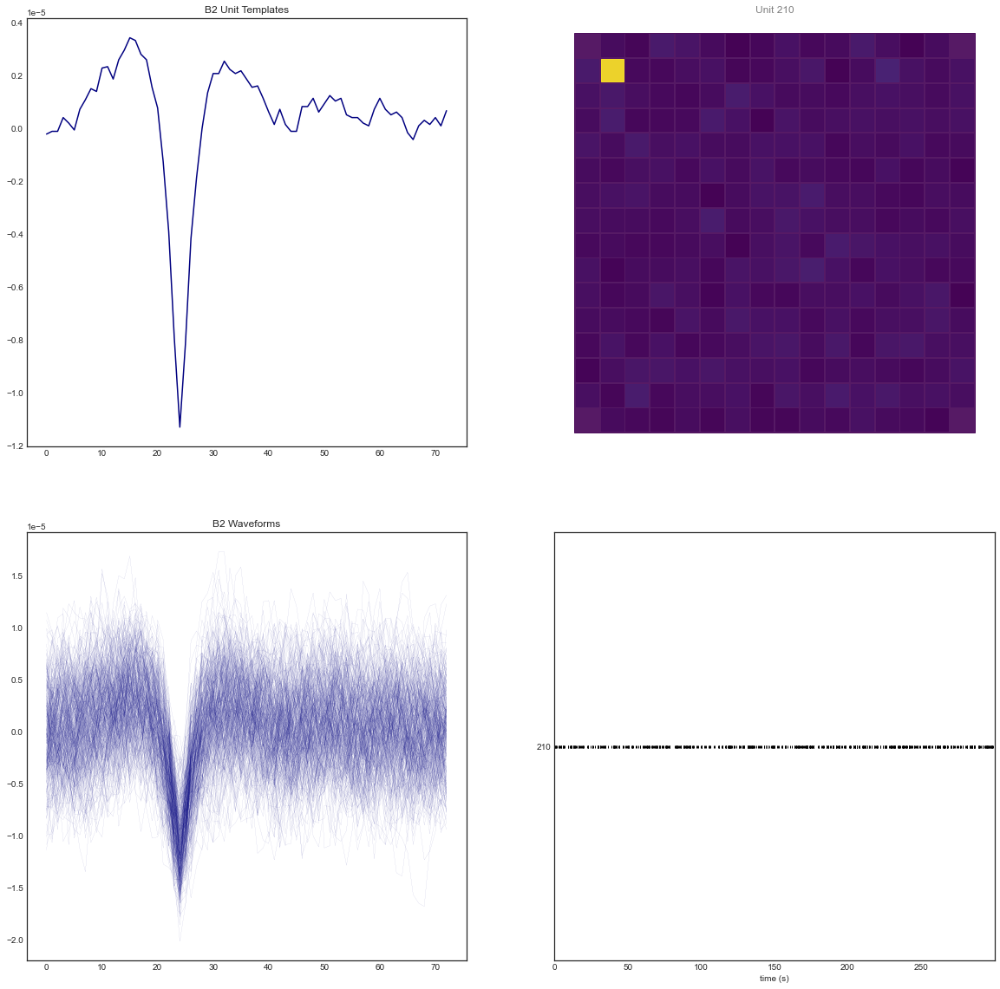

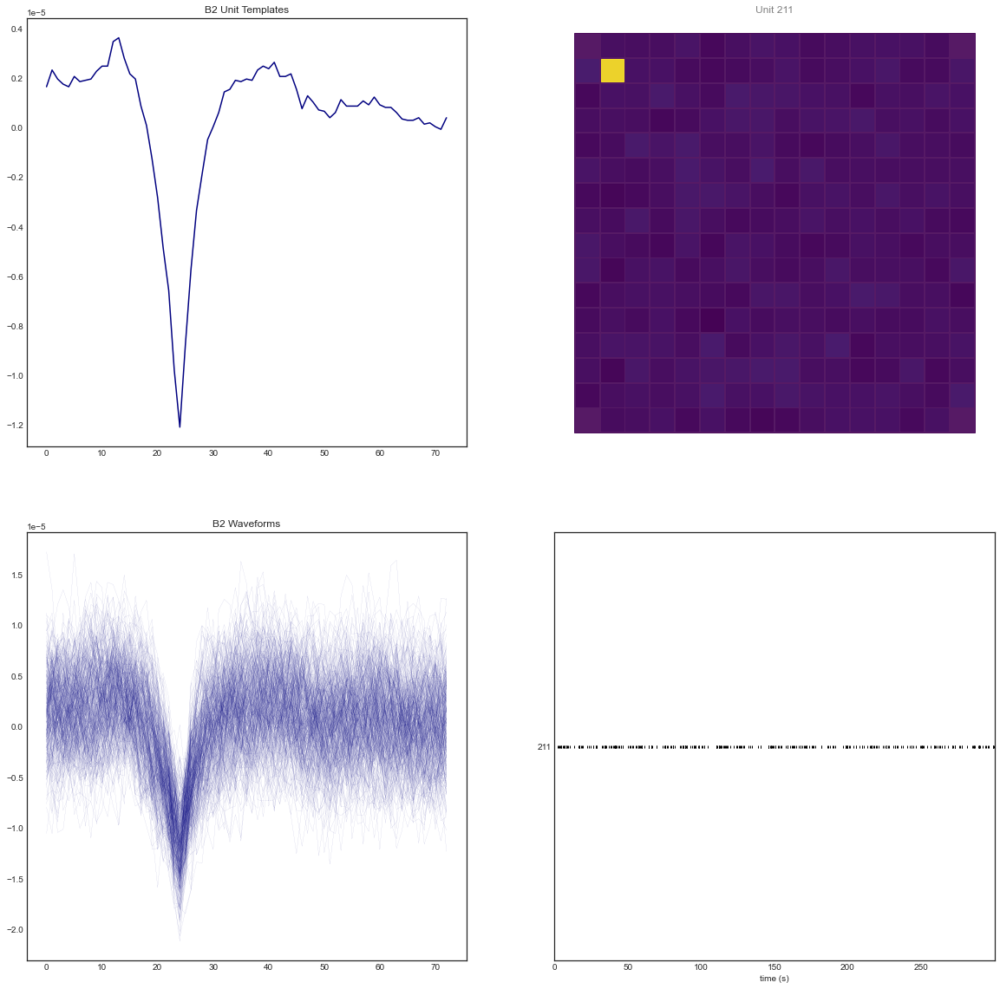

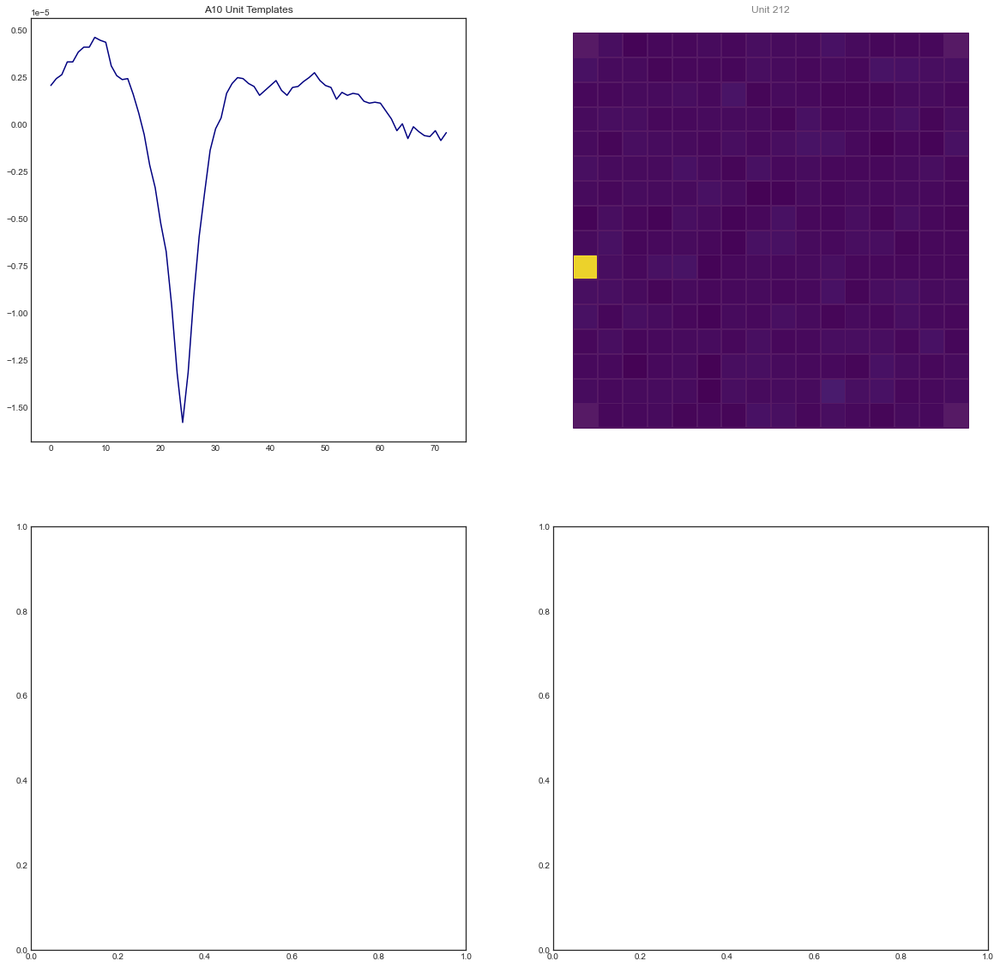

In [192]:
plot_template_plot(unit_ids, completeframe[(completeframe['subrecording']==u)])

In [239]:
i = completeframe.loc[(completeframe['unit_ids']==0)]['unit_index']

In [240]:
i

0    0.0
0    0.0
0    0.0
0    0.0
Name: unit_index, dtype: float64

In [236]:
unit_ids

0        0
1        1
2       10
3      100
4      101
      ... 
500     95
501     96
502     97
503     98
504     99
Name: unit_ids, Length: 505, dtype: int64

In [351]:
# Function works for simple unit_ids

def plot_template_fromchannel(channel, dataframe):
    
    units_ids = dataframe.loc[(dataframe['channellabel']==channel)]['unit_ids']
    
    plt.style.use("seaborn-white")
    colors = iter(cm.jet(np.linspace(0, 1, len(units_ids))))
    # get max chanel:


    fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(30, 20))

    sw.plot_unit_template_maps(loaded[u],  sorted_dic[u], max_spikes_per_unit=100, unit_ids=[list(units_ids)[0]], ax=ax6)
    
    #sw.plot_unit_waveforms(loaded[u],  sorted_dic[u], unit_ids=[list(units_ids)[0]], color='#89D1D9', ax = ax6)
   
    
    for unit in units_ids:


        i = int(dataframe.loc[(dataframe['unit_ids']==unit)]['unit_index'])
        n = len(unit_ids)
        
        
        j = int(dataframe[(dataframe['unit_ids']==unit)]['max_channel'])
        # acount for MCS counting system
        if j > 125:
            j = j-2

        colourcode = next(colors)
        ax1.plot(templates[i][j].T, color=colourcode)
        ax1.set_title(str(dataframe.loc[i]['channellabel']) + ' Unit Templates')
        

        ax4.plot(wf[i][:, j, :].T, color=colourcode, lw=0.05)
        ax4.set_title(str(dataframe.loc[i]['channellabel']) + ' Waveforms')

        #sw.plot_unit_waveforms(loaded[u],  sorted_dic[u], unit_ids=[unit], color=colourcode, ax = ax6)
    #sw.plot_crosscorrelograms(sorted_dic[u], unit_ids=unitlist_by_index, ax=ax4, bin_size=1, window=10)


    sw.plot_rasters(sorted_dic[u], color='k', unit_ids=list(units_ids), ax = ax5)
    
    sw.plot_spectrogram(loaded[u], channel=j, nfft=256, freqrange=[0, 1000], cmap='nipy_spectral', ax=ax2, )
    ax2.set_title('Spectrogram')
    
    

    sw.plot_spectrum(loaded[u], channels=[j], ax=ax3, freqrange=[0, 5000])
    
    try:
        os.mkdir(subplotpath)
    except OSError:
        print ("Creation of the directory %s failed" % outpath)
    else:
        print ("Successfully created the directory %s " % outpath)
    os.chdir(subplotpath)

    fig.savefig('unitplot_%s.png' %channel, dpi=300, bbox_inches = 'tight')

Creation of the directory D:\Files_Reutlingen_Jenny\main_191021extra\_output_Spikesorting_19042021_aCSF_adult_15min_spont_spikesorting failed


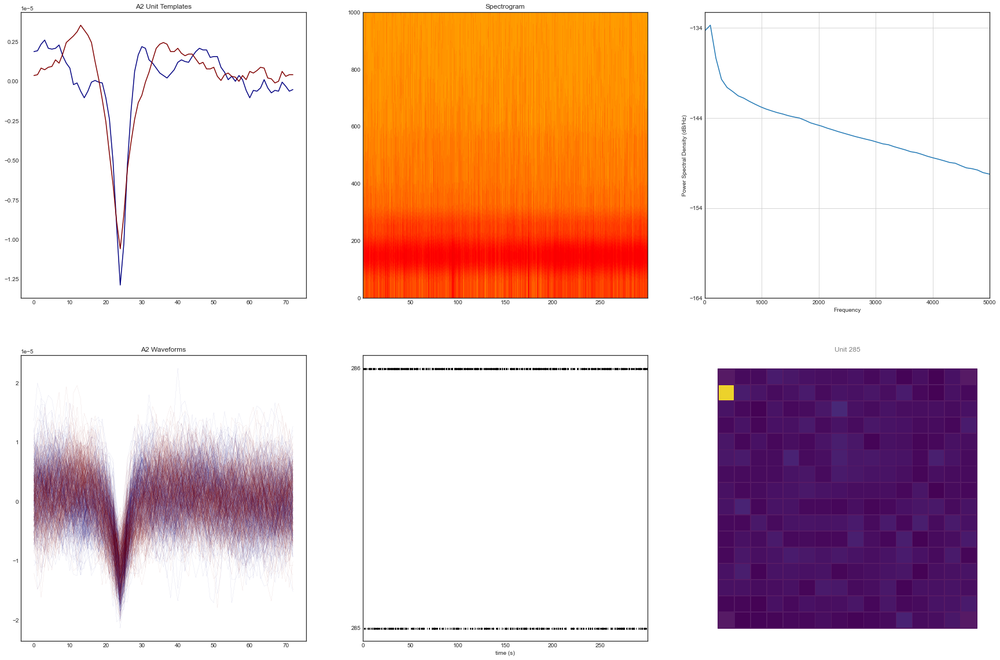

In [353]:
plot_template_fromchannel('A2', completeframe[(completeframe['subrecording']==u)])

In [164]:
# units_ids = completeframe.loc[(completeframe['channellabel']=='E12')]['unit_ids']
# colors = iter(cm.jet(np.linspace(0, 1, len(units_ids))))

In [243]:
colors

In [244]:
colourcode = next(colors)

In [245]:
colourcode

array([1.        , 0.90123457, 0.        , 1.        ])

find channels with the biggest firing rate:

In [246]:
mostspikes = completeframe.groupby('channellabel')['n_spikes'].sum()
largest_five = mostspikes.nlargest(5)

In [289]:

largest_five

channellabel
O4     18501.0
F12    17244.0
R2     14814.0
R3     14409.0
O10    14389.0
Name: n_spikes, dtype: float64

In [173]:
list(units_ids)

[193, 194, 195, 196]

{}


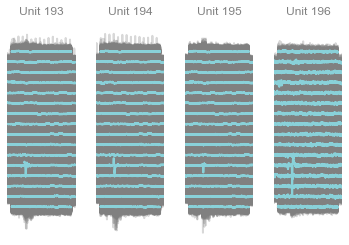

In [174]:
sw.plot_unit_waveforms(loaded[u],  sorted_dic[u], unit_ids=list(units_ids), color='#89D1D9')

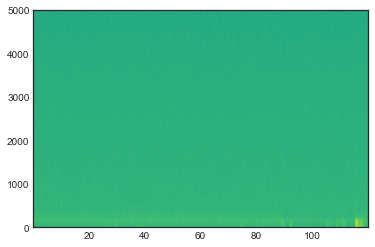

In [136]:
sw.plot_spectrogram(loaded[u], channel=1, freqrange=[0, 5000])

In [178]:
layergroup = completeframe.groupby('layer')

In [179]:
layergroup['firing_rate'].describe()

,count,mean,std,min,25%,50%,75%,max
layer,,,,,,,,
layer2-3,505.0,1.769036,2.193292,0.003333,0.356667,1.230000,2.416667,21.073336
layer4,265.0,1.564679,1.439637,0.016667,0.410000,1.260000,2.300000,10.416667
layer5-6,1271.0,1.546313,1.430227,0.003333,0.385000,1.133333,2.291667,7.963333
whitematter,93.0,1.707814,1.305817,0.030000,0.606667,1.473334,2.626667,5.190000


In [139]:
layer1 = completeframe.loc[completeframe.layer == 'layer1', 'firing_rate']
layer2_3 = completeframe.loc[completeframe.layer == 'layer2-3', 'firing_rate']
layer4 = completeframe.loc[completeframe.layer == 'layer4', 'firing_rate']
layer5_6 = completeframe.loc[completeframe.layer == 'layer5-6', 'firing_rate']
wm = completeframe.loc[completeframe.layer == 'whitematter', 'firing_rate']



In [140]:
fr_dic = {}
fr_dic['layer1']=np.asarray(layer1)
fr_dic['layer2_3']=np.asarray(layer2_3)
fr_dic['layer4']=np.asarray(layer4)
fr_dic['layer5_6']=np.asarray(layer5_6)
fr_dic['wm']=np.asarray(wm)

In [141]:
subplotpath


'D:\\Files_Reutlingen_Jenny\\Plots\\191017\\spontaneous'

C:\Users\User\anaconda3\lib\site-packages\numpy\lib\histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


Creation of the directory D:\Files_Reutlingen_Jenny\Plots\191017\spontaneous failed


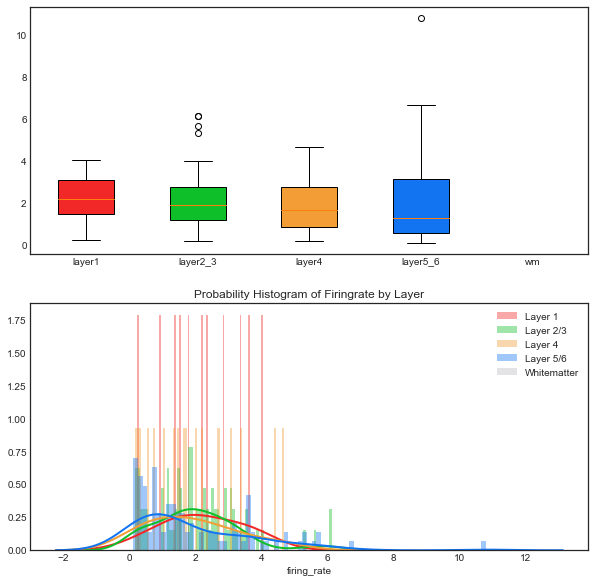

In [142]:
fig, ((ax1, ax2)) = plt.subplots(2,1, figsize=(10,10))


kwargs = dict(hist_kws={'alpha':.4}, kde_kws={'linewidth':2}, bins=75)

#plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(layer1, **kwargs, color='#F22727', label='Layer 1', ax=ax2)
sns.distplot(layer2_3, **kwargs, color='#0FBF2A', label='Layer 2/3', ax=ax2)
sns.distplot(layer4, **kwargs, color='#F29D35', label = 'Layer 4', ax=ax2)
sns.distplot(layer5_6, **kwargs, color='#1374F2', label = 'Layer 5/6', ax=ax2)
sns.distplot(wm, **kwargs, color='#BABBBF', label = 'Whitematter', ax=ax2)
ax2.set_title('Probability Histogram of Firingrate by Layer')
#plt.gca().set(title='Probability Histogram of Firingrate by Layer', ylabel='Probability', ax=ax2)
plt.legend()




box = ax1.boxplot(fr_dic.values(), patch_artist= True)

ax1.set_xticklabels(fr_dic.keys())

colors = ['#F22727', '#0FBF2A', '#F29D35', '#1374F2', '#BABBBF']
for patch, color in zip(box['boxes'], colors):
     patch.set_facecolor(color)

colors = ['#F22727', '#0FBF2A', '#F29D35', '#1374F2', '#BABBBF']

try:
    os.mkdir(subplotpath)
except OSError:
    print ("Creation of the directory %s failed" % subplotpath)
else:
    print ("Successfully created the directory %s " % subplotpath)
#os.chdir(subplotpath)


fig.savefig(os.path.join(subplotpath, 'Distplot_Firing_Rate_Layer_%s' %filebase), bbox_inches = 'tight', dpi = 300)



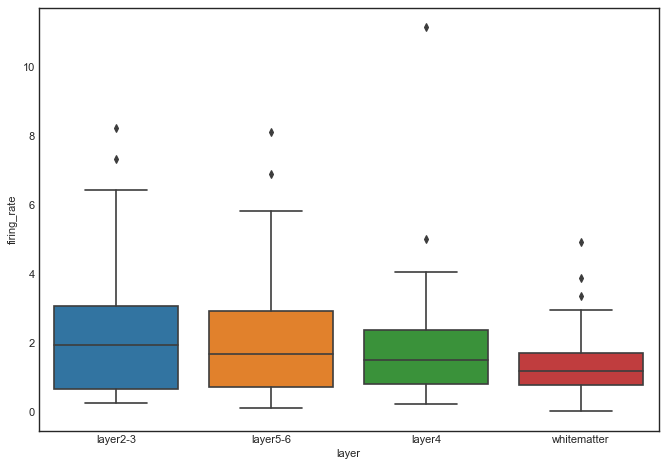

In [95]:
#fig, ((ax1, ax2)) = plt.subplots(2, 1, figsize=(10,10))

plt.figure(figsize=(10,7), dpi= 80)
sns.boxplot(x='layer', y="firing_rate", data=completeframe)
#ax1.set_title('Firing Rate per Layer')

plt.savefig(os.path.join(subplotpath, 'Boxplot_Firing_Rate_Layer_%s ' %filebase))


C:\Users\User\anaconda3\lib\site-packages\numpy\lib\histograms.py:908: RuntimeWarning: invalid value encountered in true_divide
  return n/db/n.sum(), bin_edges


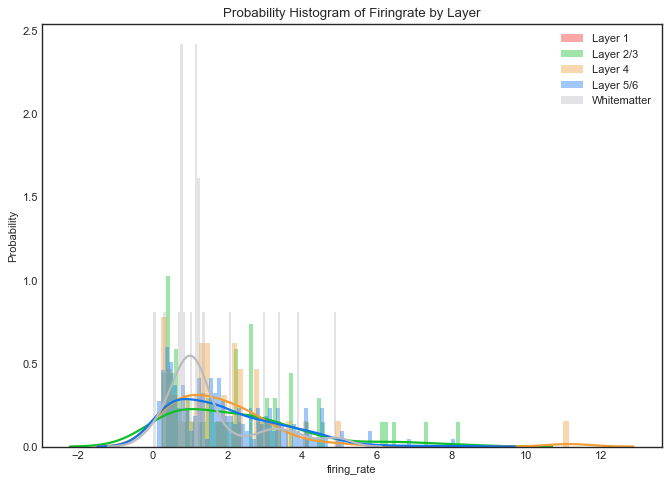

In [98]:
kwargs = dict(hist_kws={'alpha':.4}, kde_kws={'linewidth':2}, bins=75)

plt.figure(figsize=(10,7), dpi= 80)
sns.distplot(layer1, **kwargs, color='#F22727', label='Layer 1')
sns.distplot(layer2_3, **kwargs, color='#0FBF2A', label='Layer 2/3')
sns.distplot(layer4, **kwargs, color='#F29D35', label = 'Layer 4')
sns.distplot(layer5_6, **kwargs, color='#1374F2', label = 'Layer 5/6')
sns.distplot(wm, **kwargs, color='#BABBBF', label = 'Whitematter')
plt.gca().set(title='Probability Histogram of Firingrate by Layer', ylabel='Probability')
plt.legend()

plt.savefig(os.path.join(subplotpath, 'Distplot_Firing_Rate_Layer_%s ' %filebase))

In [651]:
subplotpath

'D:\\Files_Reutlingen_Jenny\\Plots\\_output_Spikesorting_30042021_spontaneous_spikesorting'

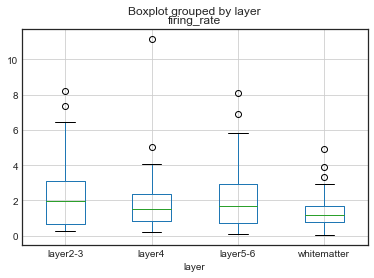

In [101]:
completeframe.boxplot('firing_rate', by='layer')

Get metadataframe from all conditions and all subrecordings:

In [143]:
os.chdir(mainpath)

In [144]:
folderlist = glob.glob('*output_spikesorting*spikesorting')

In [145]:
folderlist

['_output_Spikesorting_30042021_spontaneous_spikesorting']

In [146]:
metaframe_dict = {}

for i in folderlist:
    outpath = i
    os.chdir(os.path.join(mainpath, outpath))
    completeframes = glob.glob('*DF*complete*')
    for j in completeframes:
        metaframe_dict[i] = pd.read_pickle(j)
    


To do für den 11.05:
1. hier Funktion, die jeweils den completeframe pro ordner läd, am besten in ein dictionary
2. dann von dem dictionary ausgehend den metaframe apenden
3. Profit
4. davon Plots wie oben unter verschiedenen conditions machen

In [147]:
metaframe_dict.keys()

dict_keys(['_output_Spikesorting_30042021_spontaneous_spikesorting'])

In [148]:
def create_complete_DataFrame(frame_dic):
    '''
    Expects: a Dictionary with keys = dictkeys, e.g. 'sec_0-300' and val = DF
    
    Returns: A complete DF from all frames contained in the given frame_dictionary
    
    '''
    
    
    completeframe = frame_dic[list(frame_dic.keys())[0]]
    number_of_keys = len(list(frame_dic.keys()))
    completeframe['filekeys'] = list(frame_dic.keys())[0]
    
    for i in range(1, number_of_keys):
        subframe = frame_dic[list(frame_dic.keys())[i]]
        subframe['filekeys'] = list(frame_dic.keys())[i]
        completeframe = completeframe.append(subframe)
        
        
    return completeframe

In [149]:
metaframe = create_complete_DataFrame(metaframe_dict)

In [150]:
metaframe['filekeys'].unique()

array(['_output_Spikesorting_30042021_spontaneous_spikesorting'],
      dtype=object)

In [151]:
metaframe

,unit_ids,unit_index,max_channel,channellabel,n_spikes,firing_rate,layer,ft_peak_to_valley,ft_halfwidth,ft_peak_trough_ratio,...,ft_recovery_slope,qm_firing_rate,qm_isi_violation,qm_amplitude_cutoff,qm_presence_ratio,qm_snr,file,subrecording,recordingdate,filekeys
0,0,0.0,0.0,R12,123.0,1.025000,layer4,0.00028,0.00016,-0.221239,...,-0.002170,1.025000,0.000000,0.002104,0.74,3.815127,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
1,1,1.0,10.0,R4,219.0,1.825001,layer2-3,0.00064,0.00020,-0.116071,...,-0.002202,1.825001,2.535843,0.001182,0.90,4.106966,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
2,10,2.0,182.0,F11,21.0,0.175000,layer5-6,0.00060,0.00028,-0.106383,...,-0.010927,0.175000,0.000000,0.012323,0.07,6.900513,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
3,100,3.0,206.0,D12,154.0,1.283334,layer5-6,0.00104,0.00032,-0.153846,...,-0.002087,1.283334,1.709417,0.414959,0.28,4.733220,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
4,101,4.0,206.0,D12,22.0,0.183333,layer5-6,0.00128,0.00044,-0.287500,...,-0.002030,0.183333,0.000000,0.012002,0.08,7.281877,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204,95,204.0,176.0,F14,47.0,0.391667,layer5-6,0.00076,0.00040,-0.521739,...,-0.008802,0.391667,0.000000,0.011265,0.24,6.130469,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
205,96,205.0,176.0,F14,295.0,2.458334,layer5-6,0.00076,0.00028,-0.380952,...,-0.004627,2.458334,0.465849,0.100591,0.71,4.198039,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
206,97,206.0,196.0,C5,155.0,1.291667,layer2-3,0.00088,0.00016,-0.135135,...,-0.003849,1.291667,1.687431,0.001670,0.82,4.062950,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...
207,98,207.0,206.0,D12,51.0,0.425000,layer5-6,0.00064,0.00024,-0.365517,...,-0.011700,0.425000,15.586516,0.231702,0.11,10.558721,spontaneous,sec_0-120,17.10.2019,_output_Spikesorting_30042021_spontaneous_spik...


In [152]:
# create a dictionary for different recordings and layer from metaframe

layers = metaframe['layer'].unique()
layers = ['layer1', 'layer2-3', 'layer5-6', 'layer4', 'whitematter']
files = metaframe['filekeys'].unique()

meta_layers_fr = {}
meta_files_fr = {}
for i in layers:
    meta_files_fr = {}
    for j in files:
        files_key = j.split('spikesorting')[0].split('2021')[1]
        new_key = str(i) + str(files_key)
        fr = np.asarray(metaframe.loc[(metaframe['layer'] == i) & (metaframe['filekeys'] == j), 'firing_rate'])
        meta_files_fr[files_key] = fr
    meta_layers_fr[i] = meta_files_fr
    
meta_files_overview_fr = {}
for j in files:
    files_key = j.split('spikesorting')[0].split('2021')[1]
    fr = np.asarray(metaframe.loc[(metaframe['filekeys'] == j), 'firing_rate'])
    fr = fr[np.logical_not(np.isnan(fr))] # this line removes nan from the arrays which can cause trouble while plotting
    meta_files_overview_fr[files_key]=fr
    


        
        

In [117]:
meta_files_overview_fr

{'_spontaneous_DNQX_AP5_washin0001_': array([ 3.05833435,  0.85833362,  1.08333369,  4.00000133,  0.26666676,
         0.51666684,  0.35000012,  5.01666834,  0.95833365,  4.1083347 ,
         2.50000083,  0.38333346,  2.44166748,  1.65833389,  1.32500044,
         1.8000006 ,  3.33333444,  1.25000042,  0.45000015,  2.21666741,
         1.54166718,  0.44166681,  0.3000001 ,  1.06666702,  2.56666752,
         2.56666752,  2.27500076,  2.9083343 ,  0.98333366,  3.04166768,
         0.63333354,  2.25833409,  0.28333343,  4.50833484,  0.44166681,
         4.48333483,  0.80000027,  0.92500031,  0.85833362,  1.85000062,
         4.5000015 ,  0.80000027,  0.11666671,  0.49166683,  4.11666804,
         1.2916671 ,  1.44166715,  2.35000078,  2.33333411,  2.21666741,
         1.55833385,  1.19166706,  0.91666697,  0.6000002 ,  0.44166681,
         2.69166756,  1.73333391,  2.14166738,  1.04166701,  1.54166718,
         1.60000053,  1.36666712,  1.2916671 ,  0.81666694,  0.35833345,
         1.416

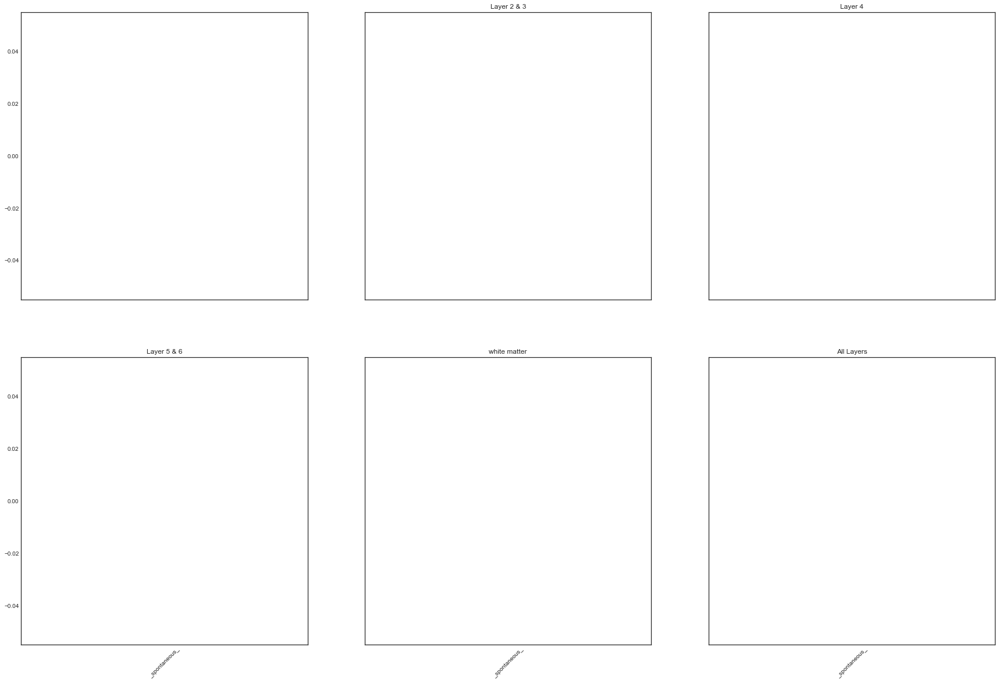

In [153]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(2, 3, figsize=(30, 20), sharey=True, sharex=True)


#box1 = ax1.boxplot(meta_layers_fr['layer1'].values(), patch_artist= True, boxprops=dict(facecolor='#F22727'))
#ax1.set_xticklabels(meta_layers_fr['layer1'].keys(), rotation = 45)

box2 = ax2.boxplot(meta_layers_fr['layer2-3'].values(), patch_artist = True, boxprops=dict(facecolor='#0FBF2A'))
patch.set_facecolor('#F29D35')
ax2.set_xticklabels(meta_layers_fr['layer2-3'].keys(), rotation = 45)
ax2.set_title('Layer 2 & 3')

box3 = ax3.boxplot(meta_layers_fr['layer4'].values(), patch_artist= True, boxprops=dict(facecolor='#F29D35'))
ax3.set_xticklabels(meta_layers_fr['layer4'].keys(), rotation = 45)
ax3.set_title('Layer 4')

box4 = ax4.boxplot(meta_layers_fr['layer5-6'].values(), patch_artist= True, boxprops=dict(facecolor='#1374F2'))
ax4.set_xticklabels(meta_layers_fr['layer5-6'].keys(), rotation = 45)
ax4.set_title('Layer 5 & 6')

box5 = ax5.boxplot(meta_layers_fr['whitematter'].values(), patch_artist= True, boxprops=dict(facecolor='#BABBBF'))
ax5.set_xticklabels(meta_layers_fr['whitematter'].keys(), rotation = 45)
ax5.set_title('white matter')

box6 = ax6.boxplot(meta_files_overview_fr.values(), patch_artist= True, boxprops=dict(facecolor='#9B91D9'))
ax6.set_xticklabels(meta_files_overview_fr.keys(), rotation = 45)
ax6.set_title('All Layers')


plt.savefig(os.path.join(subplotpath, 'Firing_overview %s' %mainpath.split('main')[1]), bbox_inches='tight')